In [3]:
import sys
import os

# Получить абсолютный путь к родительской папке
parent_dir = os.path.abspath(os.path.join(os.getcwd(), os.pardir))
sys.path.append(parent_dir)

# import osmnx as ox
import pandas as pd
import geopandas as gpd
import networkx as nx
import numpy as np
import warnings
import sys
import os

import requests
import geopandas as gpd
import pandas as pd
from popframe.models.region import Region
# from popframe.method.anchor_settlement import AnchorSettlementBuilder
import pandas as pd
import geopandas as gpd
import requests
from typing import Dict, List, Optional, Union
import time

warnings.filterwarnings("ignore")
sys.stderr = open(os.devnull, 'w')


In [2]:
%cd ..

/root/PopFrame


# Проепроцессинг

## Получение территорий

In [4]:
def fetch_territories(
    url='http://10.32.1.107:5300/api/v1/all_territories',
    parent_id=1,
    get_all_levels=False,
    territory_type_id=None,
    name=None,
    cities_only=False,
    created_at=None,
    centers_only=False
):
    params = {
        'parent_id': parent_id,
        'get_all_levels': get_all_levels,
        'territory_type_id': territory_type_id,
        'name': name,
        'cities_only': cities_only,
        'created_at': created_at,
        'centers_only': centers_only
    }
   
    response = requests.get(url, params=params)
    
    if response.status_code == 200:
        geojson_data = response.json()
        return gpd.GeoDataFrame.from_features(geojson_data['features']).set_crs(epsg=4326)
    else:
        print(f"Ошибка запроса: {response.status_code}")
        return None


## Данные по соц категориям

In [5]:
BASE_URL = "http://10.32.1.47:5000/api"
CATEGORIES = ['soc_workers', 'soc_old', 'soc_parents']
METRICS = ['dev', 'soc', 'bas']

def get_region_data(territory_id: int) -> Optional[Dict]:
    try:
        response = requests.get(
            f"{BASE_URL}/regions/values_identities",
            params={'territory_id': int(territory_id)},
            timeout=10
        )
        if response.status_code == 200:
            return response.json()
        return None
    except (requests.exceptions.RequestException, ValueError):
        return None

def fetch_unique_regions_data(territory_ids: List[int]) -> Dict[int, Dict]:
    regions_data = {}
    for territory_id in territory_ids:
        data = get_region_data(territory_id)
        regions_data[territory_id] = data
        time.sleep(0.1)  # Небольшая задержка между запросами
    return regions_data

def enrich_geodataframe(
        gdf: gpd.GeoDataFrame, 
        index: Optional[Union[int, List[int]]] = None,
        suffix_format: str = '_{index}'
    ) -> gpd.GeoDataFrame:

    # Определяем индексы для обработки
    if index is None:
        indices = [0, 1, 2]
    elif isinstance(index, int):
        indices = [index]
    else:
        indices = index

    # Проверяем валидность индексов
    if not all(0 <= i <= 2 for i in indices):
        raise ValueError("Индексы должны быть в диапазоне [0, 2]")

    # Получаем данные для уникальных parent_id
    unique_parents = gdf['parent_id'].unique()
    regions_data = fetch_unique_regions_data(unique_parents[~pd.isna(unique_parents)])

    # Создаем новые колонки для каждой метрики
    for category in CATEGORIES:
        for metric in METRICS:
            for i in indices:
                suffix = suffix_format.format(index=i) if len(indices) > 1 else ''
                column_name = f"{category}_{metric}{suffix}"

                def safe_get_value(parent_id):
                    if pd.isna(parent_id):
                        return None
                    
                    region_data = regions_data.get(parent_id)
                    if region_data is None:
                        return None
                    
                    category_data = region_data.get(category)
                    if category_data is None:
                        return None
                    
                    metric_data = category_data.get(metric)
                    if metric_data is None or i >= len(metric_data):
                        return None
                    
                    return metric_data[i]
                
                gdf[column_name] = gdf['parent_id'].apply(safe_get_value)

    return gdf

def enrich_with_region_data(
        gdf: gpd.GeoDataFrame, 
        index: Optional[Union[int, List[int]]] = None,
        suffix_format: str = '_{index}'
    ) -> gpd.GeoDataFrame:

    enriched_gdf = enrich_geodataframe(gdf, index, suffix_format)

    return enriched_gdf


## Функция поиска родительской территории по типу

In [6]:
# Глобальный словарь для хранения информации о территориях
territory_dict = {}

def initialize_territory_dict(gdf: gpd.GeoDataFrame):
    global territory_dict
    territory_dict = {
        row['id']: {
            'level': row['level'],
            'parent_id': row['parent']['id'] if pd.notna(row['parent']) else None,
            'name': row['name']  # Добавляем name в словарь
        }
        for _, row in gdf.iterrows()
    }

def find_parent_info(id: int, target_type_id: int) -> tuple:
    if id not in territory_dict:
        return None, None

    current = territory_dict[id]
    if not current['parent_id']:
        return None, None

    parent = territory_dict.get(current['parent_id'])
    if parent and parent['level'] == target_type_id:
        return current['parent_id'], parent['name']

    return find_parent_info(current['parent_id'], target_type_id)

def find_parent_ids(target_gdf: gpd.GeoDataFrame, 
                   reference_gdf: gpd.GeoDataFrame, 
                   target_type_id: int) -> gpd.GeoDataFrame:
    # Инициализируем словарь территорий на основе reference_gdf
    initialize_territory_dict(reference_gdf)
    
    # Применяем функцию поиска parent_id и name для каждой территории в target_gdf
    parent_info = target_gdf['id'].apply(
        lambda x: find_parent_info(x, target_type_id)
    )
    
    # Разделяем результаты на два столбца
    target_gdf['parent_id'] = [info[0] if info else None for info in parent_info]
    target_gdf['parent_name'] = [info[1] if info else None for info in parent_info]
    
    return target_gdf

## Получение данных из TownsNet

In [7]:
API_URL = "http://10.32.1.102:5510/provision/{region_id}/get_evaluation"

CATEGORIES = ["Базовая", "Дополнительная", "Комфорт"]
CATEGORIES_COLUMNS = ['basic', 'additional', 'comfort']

def fetch_gdf(region_id: int, category_name: str, category_column: str):
    params = {"category": category_name}
    
    response = requests.get(API_URL.format(region_id=region_id), params=params)
    if response.status_code == 200:
        data = response.json()
        gdf = gpd.GeoDataFrame.from_features(data["features"])
        gdf = gdf[["geometry", category_column]]
        return gdf
    else:
        raise Exception(f"API request failed with status {response.status_code}")

def fetch_all_categories(region_id: int):
    gdfs = [fetch_gdf(region_id, name, category_column) for name, category_column in zip(CATEGORIES,CATEGORIES_COLUMNS)]
    
    combined_gdf = gdfs[0]
    
    for gdf, category in zip(gdfs[1:], CATEGORIES_COLUMNS[1:]):
        combined_gdf = combined_gdf.merge(gdf[["geometry", category]], on="geometry", how="outer")
    
    return combined_gdf

In [8]:
def get_population(territories_gdf: gpd.GeoDataFrame):
    POPULATION_COUNT_INDICATOR_ID =1 
    URBAN_API = 'http://10.32.1.107:5300'
    res = requests.get(f'{URBAN_API}/api/v1/indicator/{POPULATION_COUNT_INDICATOR_ID}/values', verify=False)
    res.raise_for_status()
    res_df = pd.DataFrame(res.json())
    
    res_df['territory_id'] = res_df['territory'].apply(lambda x: x['id'] if isinstance(x, dict) else None)
    res_df = res_df[res_df['territory_id'].isin(territories_gdf['id'].values)]
    res_df = (
        res_df
        .groupby('territory_id')
        .agg({'value': 'last'})
        .rename(columns={'value': 'population'})
    )
    
    territories_gdf = territories_gdf.merge(res_df,  left_on='id', right_on='territory_id', how='left')
    territories_gdf['population'] = territories_gdf['population'].fillna(0)  # Заменяем NaN на 0
    
    return territories_gdf

## Получаем данные по городам и ГПСП

In [ ]:
all_territories = fetch_territories(parent_id=1, get_all_levels=True, cities_only=False, centers_only=True)
all_territories.to_parquet('all_territories.parquet')

all_territories

In [9]:
all_territories = gpd.read_parquet('data/all_territories.parquet')
all_territories = all_territories.reset_index().rename(columns={'territory_id': 'id'})

Данные сохранены в файлы, при необходимиости можно раскомментировать код и получить обновленные данные

In [ ]:
# Получение данных о городах
towns_gdf = fetch_territories(parent_id=1, get_all_levels=True, cities_only=True, centers_only=True)

In [39]:
towns_gdf['is_anchor_settlement'] = towns_gdf['target_city_type'].apply(lambda x: x is not None and 'id' in x)
towns_gdf["is_anchor_settlement"] = towns_gdf["is_anchor_settlement"].astype(bool)
towns_gdf = towns_gdf[['geometry', 'territory_id', 'name', 'is_anchor_settlement']]
towns_gdf = towns_gdf.reset_index().rename(columns={'territory_id': 'id'})

In [41]:
towns_gdf[towns_gdf['is_anchor_settlement'] == True]

,index,geometry,id,name,is_anchor_settlement
121,121,POINT (33.84753 59.47381),328,г. Бокситогорск,True
128,128,POINT (34.17817 59.51296),335,г. Пикалево,True
259,259,POINT (28.60121 59.37805),466,г. Кингисепп,True
261,261,POINT (28.21971 59.37649),468,г. Ивангород,True
350,350,POINT (28.26664 59.65768),557,п. Усть-Луга,True
449,449,POINT (32.00872 59.4497),656,г. Кириши,True
526,526,POINT (30.98146 59.87533),733,г. Кировск,True
529,529,POINT (30.79455 59.77409),736,г. Отрадное,True
630,630,POINT (33.54589 60.73455),837,г. Лодейное Поле,True
911,911,POINT (34.16693 60.91276),1118,г. Подпорожье,True


In [ ]:
towns_gdf[towns_gdf['is_anchor_settlement'] == True].explore()

In [11]:
# towns_gdf = find_parent_ids(towns_gdf, all_territories, target_type_id=4)

In [12]:
# towns_gdf = get_population(towns_gdf)

In [13]:
# towns_gdf = enrich_with_region_data(towns_gdf, index=0)

In [ ]:
provision_gdf = fetch_all_categories(1)
provision_gdf = provision_gdf.set_crs(epsg=4326)

# Добавляем буфер вокруг точек в gdf1
orig_geometry = towns_gdf['geometry']
towns_gdf['geometry'] = towns_gdf.geometry.buffer(0.002)
towns_gdf = towns_gdf.sjoin(provision_gdf, how='left', predicate='intersects')
towns_gdf['geometry'] = orig_geometry
towns_gdf['provision'] = towns_gdf[['basic', 'additional', 'comfort']].mean(axis=1)
towns_gdf.to_parquet('towns_gdf.parquet')

In [43]:
towns_gdf = gpd.read_parquet('data/cities_gdf.parquet')
towns_gdf['provision'] = towns_gdf[['basic', 'additional', 'comfort']].mean(axis=1)
towns_gdf = towns_gdf.set_index("id", drop=False)
towns_gdf = towns_gdf.fillna(0)
towns_gdf = towns_gdf.to_crs(4326)

# Работа метода

## Границы опорных пунктов

In [4]:
import geopandas as gpd
from popframe.models.region import Region
from popframe.method.anchor_settlement import AnchorSettlementBuilder

# Создаем экземпляр класса
region_model = Region.from_pickle('data/1.pickle')
builder = AnchorSettlementBuilder(region=region_model)

# Вызываем метод построения границ
towns_gdf = gpd.read_parquet('data/cities_gdf.parquet')
settlement_boundaries = builder.get_anchor_settlement_boundaries(towns_gdf, time = 50)

e:\Github\Job\.venv\Lib\site-packages\shapely\set_operations.py:133: RuntimeWarning: invalid value encountered in intersection
  return lib.intersection(a, b, **kwargs)
e:\Github\Job\.venv\Lib\site-packages\shapely\set_operations.py:133: RuntimeWarning: invalid value encountered in intersection
  return lib.intersection(a, b, **kwargs)
e:\Github\Job\.venv\Lib\site-packages\shapely\set_operations.py:133: RuntimeWarning: invalid value encountered in intersection
  return lib.intersection(a, b, **kwargs)
e:\Github\Job\.venv\Lib\site-packages\shapely\set_operations.py:133: RuntimeWarning: invalid value encountered in intersection
  return lib.intersection(a, b, **kwargs)
e:\Github\Job\.venv\Lib\site-packages\shapely\set_operations.py:133: RuntimeWarning: invalid value encountered in intersection
  return lib.intersection(a, b, **kwargs)
e:\Github\Job\.venv\Lib\site-packages\shapely\set_operations.py:133: RuntimeWarning: invalid value encountered in intersection
  return lib.intersection(a,

In [10]:
# settlement_boundaries.to_file("settlement_boundaries.gpkg", driver="GPKG")
settlement_boundaries.to_parquet("path_to_file.parquet")


In [ ]:
import requests
import geopandas as gpd
import pandas as pd

# Загрузка вашего GeoDataFrame
gdf = towns_gdf.copy()

# API-адрес
URBAN_API = "https://urban-api.idu.kanootoko.org/api/v1"

# Словарь для хранения всех значений индикаторов
all_indicators = {}

for territory_id in gdf["id"]:
    try:
        # Формируем URL
        url = f"{URBAN_API}/territory/{territory_id}/indicator_values"
        
        # Выполняем GET-запрос
        response = requests.get(url)
        
        # Проверяем статус ответа
        if response.status_code != 200:
            print(f"Ошибка при запросе {territory_id}: {response.status_code}")
            continue
        
        # Обрабатываем JSON-ответ
        res_json = response.json()

        # Собираем индикаторы в словарь
        indicators = {item["indicator"]["name_full"]: item["value"] for item in res_json}
        all_indicators[territory_id] = indicators

    except Exception as e:
        print(f"Ошибка при обработке {territory_id}: {e}")
        continue

# Преобразуем в DataFrame
indicators_df = pd.DataFrame.from_dict(all_indicators, orient="index").reset_index()
indicators_df.rename(columns={"index": "id"}, inplace=True)

# Объединяем с исходным GeoDataFrame
gdf = gdf.merge(indicators_df, on="id", how="left")
gdf.drop(columns=['index_right'], inplace=True)


In [41]:
pd.options.display.max_columns = None
settlement_boundaries.explore()

In [27]:
joined = gpd.sjoin(
    gdf, 
    settlement_boundaries,
    how='left',  # 'left' — сохранить все точки, даже если они не попали в полигон
    predicate='within'  # 'within' — проверка, что точка внутри полигона
)


In [ ]:
settlement_boundaries[settlement_boundaries['anchor_name'] == "г. Бокситогорск"].plot()
joined[joined['anchor_name'] == "г. Бокситогорск"].plot()

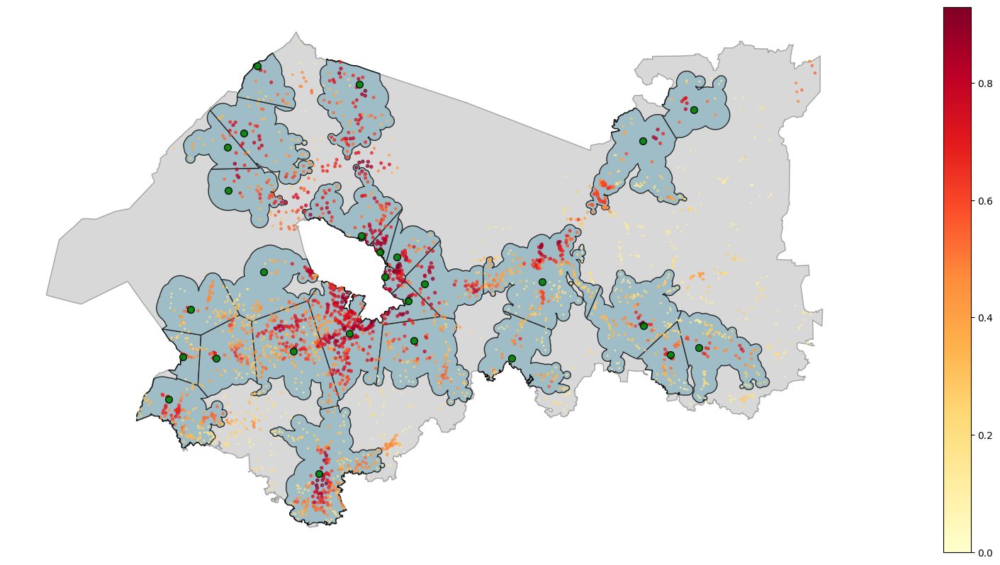

In [ ]:
import matplotlib.pyplot as plt
import geopandas as gpd

# Создание графика и оси
fig, ax = plt.subplots(figsize=(30, 10))

# Визуализация границ с заливкой светло-голубым цветом
settlement_boundaries.plot(ax=ax, edgecolor="black", facecolor="#ADD8E6", linewidth=1)

# Визуализация границ региона (серым цветом с прозрачностью)
region_boundary = region_model.region
region_boundary.plot(ax=ax, color='gray', edgecolor='black', alpha=0.3)

local_crs = region_boundary.crs

        
non_anchor_towns = towns_gdf[towns_gdf["is_anchor_settlement"] == False]  # Не опорные города
anchor_towns = towns_gdf[towns_gdf["is_anchor_settlement"] == True]  # Опорные города

non_anchor_towns = non_anchor_towns.to_crs(local_crs)
anchor_towns = anchor_towns.to_crs(local_crs)

# Визуализация не опорных городов (тепловая карта по provision)
non_anchor_towns.plot(
    ax=ax, 
    column="basic",  # Градиент по 'provision'
    cmap="YlOrRd",  # От жёлтого к красному
    legend=True,  # Включаем легенду
    markersize=non_anchor_towns["basic"] * 10,  # Размер точек по значению
    alpha=0.7
)

# Визуализация опорных городов (зелёным цветом)
anchor_towns.plot(
    ax=ax,
    color="green",  # Фиксированный зелёный цвет
    markersize=50,  # Размер маркеров
    alpha=0.9,
    edgecolor="black"
)


# Настройки отображения
ax.set_axis_off()

# Показ графика
plt.show()


## Пространственное неравенство

In [ ]:
from popframe.method.spatial_inequality import SpatialInequalityCalculator

region_model = Region.from_pickle('data/1.pickle')
calculator = SpatialInequalityCalculator(region=region_model)

In [21]:
spatial_inequality_gdf = calculator.calculate_spatial_inequality(towns_gdf)

In [24]:
polygon_spatial_inequality, stats_json = calculator.calculate_polygon_spatial_inequality(spatial_inequality_gdf, settlement_boundaries)

In [27]:
from pprint import pprint 
pprint(stats_json)

{'inside_stats': {'additional': 0.3468072289156627,
                  'basic': 0.5158907056798623,
                  'comfort': 0.4710370051635111,
                  'provision': 0.44457831325301195,
                  'soc_old_bas': 0.5837642861564459,
                  'soc_old_dev': 0.8911372363867217,
                  'soc_old_soc': 0.9183376318238162,
                  'soc_parents_bas': 0.8809843393457492,
                  'soc_parents_dev': 0.7584366849014872,
                  'soc_parents_soc': 0.9103601834792308,
                  'soc_workers_bas': 0.5971705542743548,
                  'soc_workers_dev': 1.0,
                  'soc_workers_soc': 0.9121025133832324,
                  'spatial_inequality': 0.7100466679048528},
 'outside_stats': {'additional': 0.7079077429983526,
                   'basic': 0.7649917627677101,
                   'comfort': 0.7331136738056013,
                   'provision': 0.735337726523888,
                   'soc_old_bas': 0.585342266809257

In [25]:
# Использование с раскраской по конкретному атрибуту
m = calculator.create_interactive_map(spatial_inequality_gdf,
                                    polygon_spatial_inequality,
                                    selected_attribute='spatial_inequality',
                                    color_by_average=True,
                                    vmin=None, vmax=None)
m

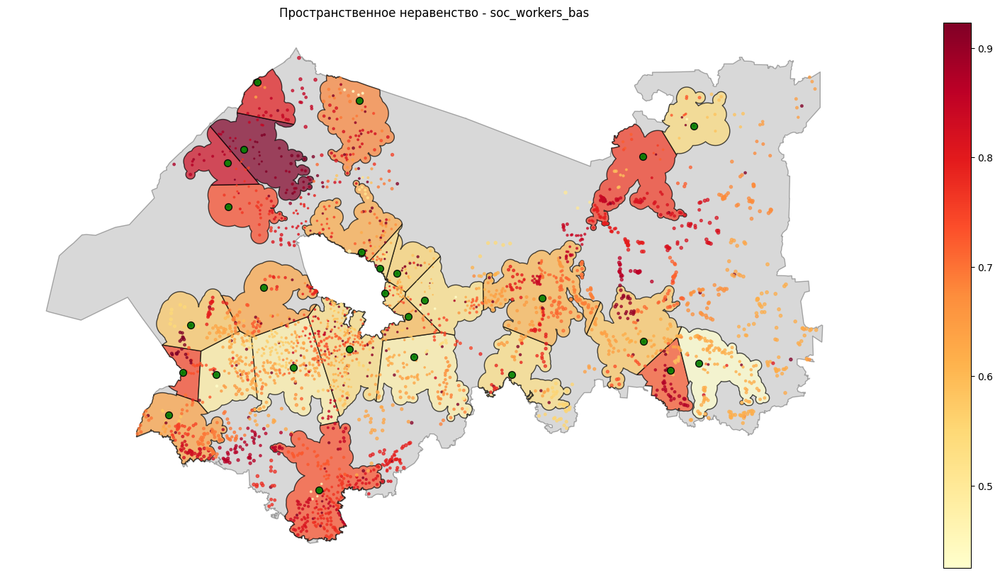

In [28]:
import matplotlib.pyplot as plt
import geopandas as gpd
import contextily as ctx

# Создание графика и оси
fig, ax = plt.subplots(figsize=(30, 10))


# Визуализация границ региона (серым цветом с прозрачностью)
region_boundary = region_model.region
region_boundary.plot(ax=ax, color='gray', edgecolor='black', alpha=0.3)
local_crs = region_boundary.crs
polygon_spatial_inequality = polygon_spatial_inequality.to_crs(local_crs)
spatial_inequality_gdf = spatial_inequality_gdf.to_crs(local_crs)
anchor_towns = anchor_towns.to_crs(local_crs)
# Визуализация границ с заливкой по 'provision'
polygon_spatial_inequality.plot(
    ax=ax,
    column="soc_workers_bas",  # Градиент по 'provision'
    cmap="YlOrRd",  # От жёлтого к красному
    edgecolor="black",
    linewidth=1,
    legend=True,
    alpha=0.7
)

# Визуализация не опорных городов (тепловая карта по provision)
spatial_inequality_gdf.plot(
    ax=ax, 
    column="soc_workers_bas",  # Градиент по 'provision'
    cmap="YlOrRd",  # От жёлтого к красному
    legend=False,  # Включаем легенду
    markersize=spatial_inequality_gdf["provision"] * 10,  # Размер точек по значению
    alpha=0.7
)

# Визуализация опорных городов (зелёным цветом)
anchor_towns.plot(
    ax=ax,
    color="green",  # Фиксированный зелёный цвет
    markersize=50,  # Размер маркеров
    alpha=0.9,
    edgecolor="black"
)

# Настройки отображения
ax.set_title("Пространственное неравенство - soc_workers_bas")
ax.set_axis_off()

# Показ графика
plt.show()
